In [1]:
import spatialdata as sd
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import scanpy as sc
import squidpy as sq
import anndata as ad
from matplotlib.colors import ListedColormap

import pickle
import warnings
warnings.filterwarnings("ignore")       

/software/cellgen/team298/ls34/NEMO2/lib/python3.10/site-packages/dask/dataframe/__init__.py:31: FutureWarning: The legacy Dask DataFrame implementation is deprecated and will be removed in a future version. Set the configuration option `dataframe.query-planning` to `True` or None to enable the new Dask Dataframe implementation and silence this warning.
  warnings.warn(
/software/cellgen/team298/ls34/NEMO2/lib/python3.10/site-packages/anndata/utils.py:434: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  warnings.warn(msg, FutureWarning)


In [2]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.settings.figdir = "supp"
sc.settings.set_figure_params(dpi_save=300, facecolor="white", frameon=False, figsize=(25,25))


In [3]:
#adata=sc.read_h5ad('/nfs/team298/ls34/adult_skin/final_adatas/adata_combined_new.h5ad.v8_nohealthy')
PATH = '/nfs/team298/ls34/adult_skin/final_adatas/adata_combined_new.h5ad.final.filtered'
adata=sc.read_h5ad(PATH)
adata_5k=adata[adata.obs["tech"]=="xenium"].copy()
adata=adata[adata.obs["tech"]!="xenium"].copy()

#adata=sc.read_h5ad('/nfs/team298/ls34/adult_skin/final_adatas/adata_combined_new.h5ad.final.filtered.scrna')

import gc
gc.collect()


#adata=sc.read_h5ad(PATH2)
def remove_markers(LIST):
    try: 
        LIST = {key: [gene for gene in genes if gene in adata.var_names] 
                           for key, genes in LIST.items()}
    except: 
        LIST =[gene for gene in LIST if gene in adata.var_names]
    return LIST

 

 

In [4]:
adata_5k.obs["Annotation"]=adata_5k.obs["lvl5_annotation"]
adata_5k.obs["Annotation"].value_counts()

Annotation
KC3                 189820
KC1                 126090
F2: Universal       100872
Pericyte1            85232
VE3_Ven              69056
                     ...  
Neutrophil              17
KC_HF: HS               14
ILC_Prolif              12
ILC1_NCR2+P2RX7+         8
Mac_CX3CR1+              8
Name: count, Length: 100, dtype: int64

# Perineural mac

0 True
Baseline_never_CE3-SKI-28-FO-2-S22-C1 - Cell count:  1


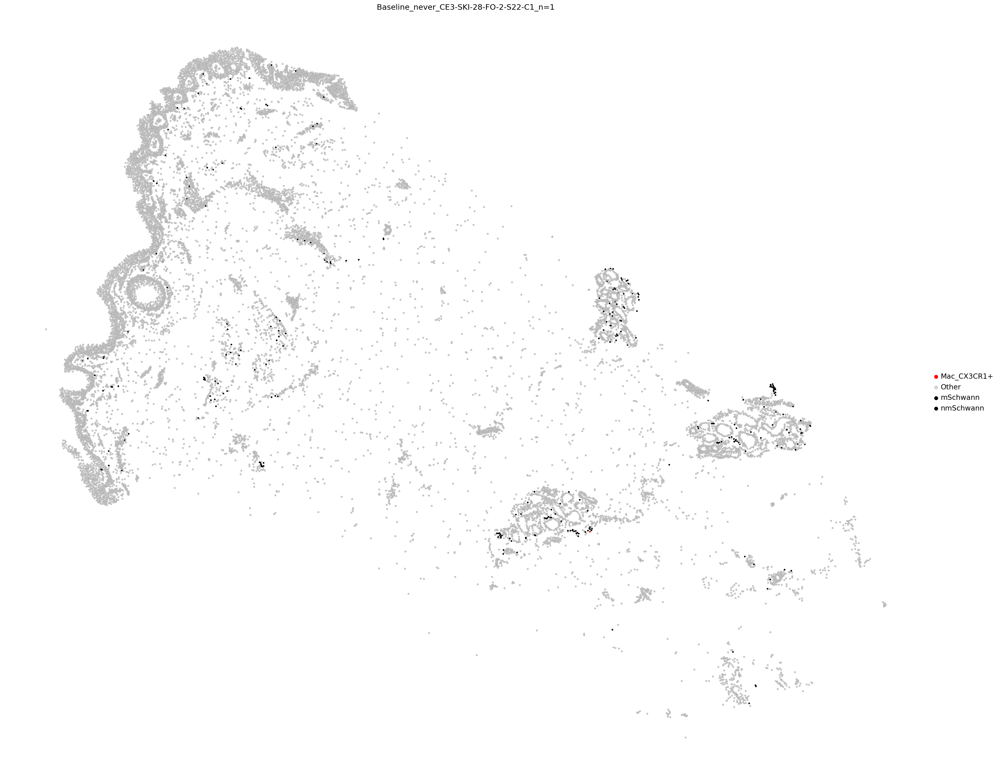

In [5]:
CELL_TYPE = 'Mac_CX3CR1+'
MIN_CELL_COUNT=1


i=0
#adata_5k=adata_5k[adata_5k.obs["Site_status_binary"]=="Lesional"]
for tissue_section_id in [ 'Baseline_never_CE3-SKI-28-FO-2-S22-C1']:
    adata_i =  adata_5k[adata_5k.obs["info_id6"]==tissue_section_id]
    niche_names_found = adata_i.obs["Annotation"].unique()
    STATUS =  adata_i.obs["info_id6"].unique()[0]
    print(i, CELL_TYPE in niche_names_found)
    if CELL_TYPE in niche_names_found:
        CELL_COUNT_IN_SECTION=adata_i[adata_i.obs["Annotation"]==CELL_TYPE].shape[0]
        print(tissue_section_id, "- Cell count: ", CELL_COUNT_IN_SECTION)

        if CELL_COUNT_IN_SECTION >= MIN_CELL_COUNT: 
            i=i+1
            adata_i.obs["test"] = [x if x == CELL_TYPE or "Schwann" in x else "Other" for x in adata_i.obs["Annotation"]]
            NUM = ord(CELL_TYPE[0])
            if NUM <79:
                custom_palette =ListedColormap([  "red",  "lightgrey", 'black',])
            else:
                custom_palette = ListedColormap([  "lightgrey", "red", 'black'])
            #print(x)
            if tissue_section_id =="Baseline_never_CE3-SKI-28-FO-2-S22-C1":
                sq.pl.spatial_scatter(
                        adata_i,
                        library_id="spatial",
                        shape=None,
                        color="test",
                        size=30,
                        vmax=1,
                        title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
                        palette=custom_palette,
                      edgecolor='black',
                        linewidth=0.1,
                        #ax=ax,
                        #legend_loc="on data"  # Disable the legend for each subplot
                    )
         
            else:
                1

                                    #ax=ax,
                                    #legend_loc="on data"  # Disable the legend for each subplot
 
        else:
             print(STATUS, " - does not contain ", CELL_TYPE, ". Count is " , CELL_COUNT_IN_SECTION,)# " - i=", i)

# ILC3

In [6]:
file_path = '/nfs/team298/ls34/color_for_adult_skin2.pkl' 

with open(file_path, 'rb') as f:   # rb = read-binary
    COLOUR_MAP = pickle.load(f)



In [7]:
CATEGORY="lvl5_annotation"

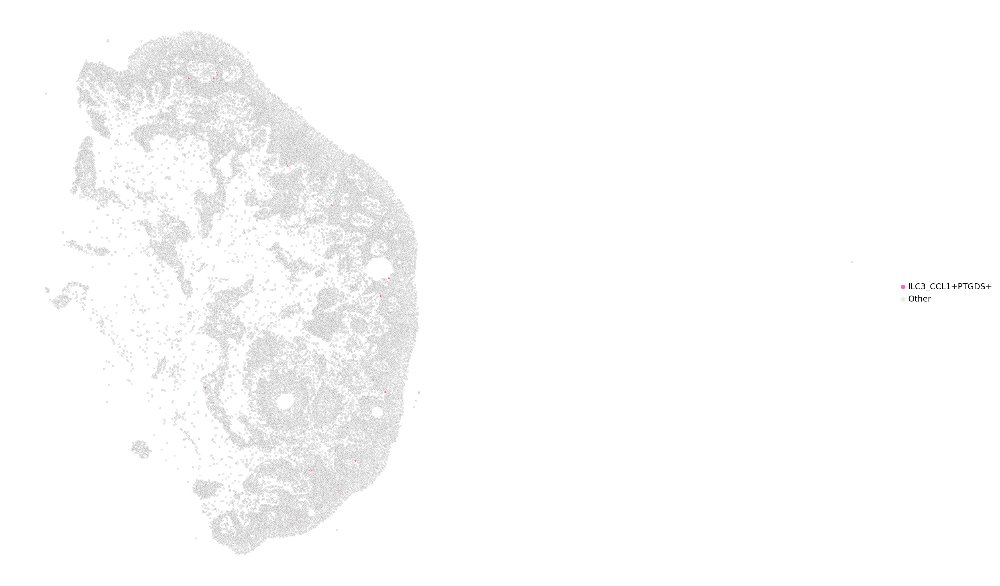

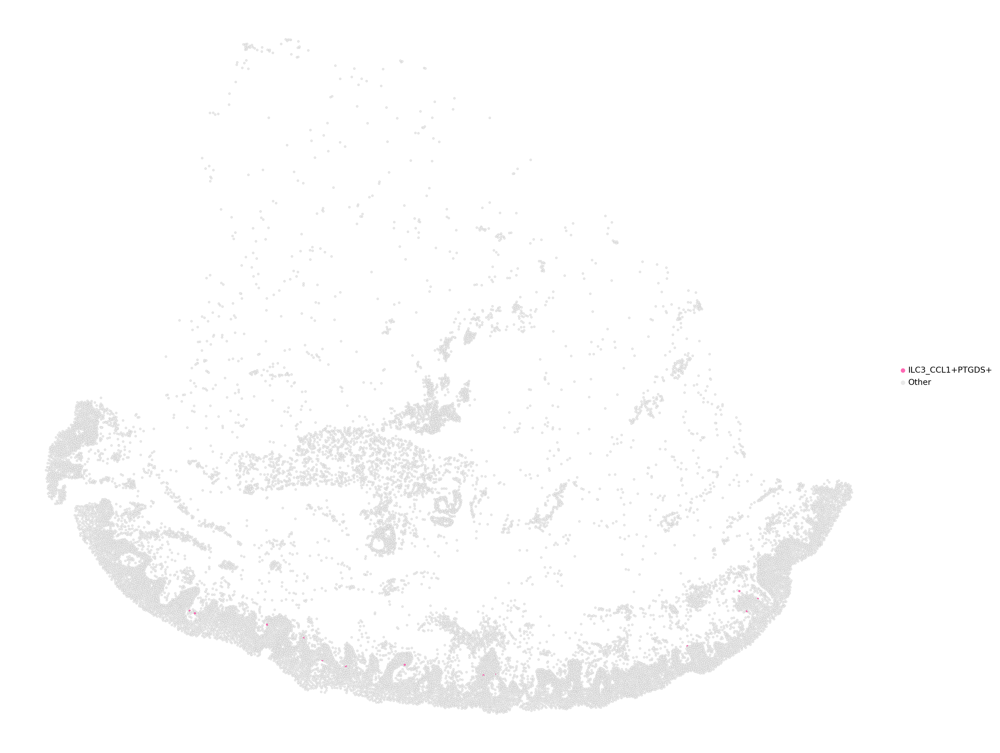

In [8]:
CELL_TYPE = 'ILC3_CCL1+PTGDS+'
MIN_CELL_COUNT=9


i=0

for tissue_section_id in ['BK39_Week 12',
                          'BK18_Lesional Baseline',
                         # "BK25_Week 12",
                        ]  :
    adata_i =  adata_5k[adata_5k.obs["info_id6"]==tissue_section_id]
    adata_i.obs["test"] = [x if x == CELL_TYPE else "Other" for x in adata_i.obs["lvl5_annotation"]]
    NUM = ord(CELL_TYPE[0])
    if NUM <79:
        custom_palette = [ COLOUR_MAP[CELL_TYPE],  "#E9E9E9"]
    else:
        custom_palette = [  "#E9E9E9", COLOUR_MAP[CELL_TYPE]]
    sc.pl.spatial(
            adata_i,
            #library_id="spatial",
            #shape=None,
            color="test",
            spot_size=12,
            vmax=1,
        title='',
            #title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
            palette=custom_palette,
            edgecolor='black',
            linewidth=0.05,
        save=f"{tissue_section_id}_ILC3CCL1.pdf"
            #ax=ax,
            #legend_loc="on data"  # Disable the legend for each subplot
        )
#     sq.pl.spatial_scatter(
#             adata_i,
#             library_id="spatial",
#             shape=None,
#             color="lvl5_annotation",
#             size=30,
#             vmax=1,
#             #title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
#           #  palette=custom_palette,
#             edgecolor='black',
#             linewidth=0.01,
#             #ax=ax,
#             #legend_loc="on data"  # Disable the legend for each subplot
#         )
# #             if i >5:
# #                 print("6 samples found already ... Terminate")
# #                 break


# All ILCs

In [9]:
adata=adata_5k
[x for x in adata.obs["Annotation"].unique() if x.startswith("ILC")]

['ILC3', 'ILC2', 'ILC3_CCL1+PTGDS+', 'ILC1', 'ILC1_NCR2+P2RX7+', 'ILC_Prolif']

In [10]:
# file_path = '/nfs/team298/ls34/color_for_adult_skin2.pkl' import pickle

# # Load the dict back
# with open('/nfs/team298/ls34/niche_colors.pkl', 'rb') as f:   # rb = read-binary
#     colors_new2_loaded = pickle.load(f)



In [11]:
# COLOR_PICKLE_PATH= '/nfs/team298/ls34/color_for_adult_skin2.pkl'
# with open(COLOR_PICKLE_PATH, 'rb') as f:
#     colors = pickle.load(f)


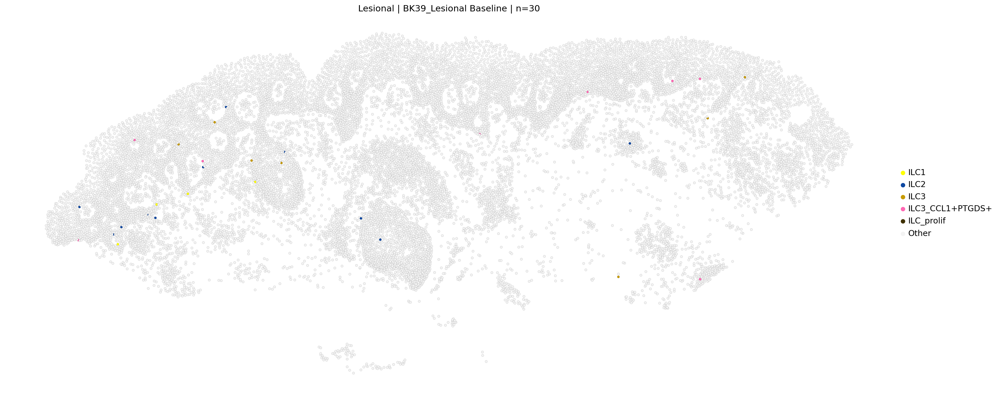

In [12]:
TARGET_TYPES   = {"ILC1", "ILC2", "ILC3", "ILC3_CCL1+PTGDS+" , "ILC_prolif"}
# COLOUR_MAP     = {                 # hexes = colour-blind–safe “Set1”
#     "ILC1":  "#e41a1c",            # red
#     "ILC2":  "#377eb8",            # blue
#     "ILC3":  "#4daf4a",            # green
#     "ILC3_CCL1+PTGDS+": "#FFA500",
#      "ILC_prolif": "#000000",
#     "Other": "#EFEFEF"
# }
MIN_CELL_COUNT = 1
i = 0

for tissue_section_id in adata_5k.obs["sample_id"].unique():
    adata_i = adata_5k[adata_5k.obs["sample_id"] == tissue_section_id]
    status  = adata_i.obs["Site_status"].iloc[0]
    annos   = adata_i.obs["Annotation"]

    # skip sections with none of the target types
    if not TARGET_TYPES.intersection(annos.unique()):
        continue

    # count target cells
    target_mask       = annos.isin(TARGET_TYPES)
    target_cell_count = int(target_mask.sum())
    if target_cell_count < MIN_CELL_COUNT:
        continue

    # assign plotting group per cell
    
    # make sure "Other" is an allowed category BEFORE we call .where
    if "Other" not in annos.cat.categories:
        annos = annos.cat.add_categories(["Other"])

    # create the plotting series
    plot_group = annos.where(annos.isin(TARGET_TYPES), "Other")
    plot_group = (
        plot_group.astype("category")
                  .cat.set_categories(["ILC1", "ILC2", "ILC3", "ILC3_CCL1+PTGDS+",  "ILC_prolif",  "Other"])
    )
    adata_i.obs["plot_group"] = plot_group
    
    
#     adata_i.obs["plot_group"] = annos.where(annos.isin(TARGET_TYPES), "Other")
#     adata_i.obs["plot_group"] = (
#         adata_i.obs["plot_group"]
#         .astype("category")
#         .cat.set_categories(["ILC1", "ILC2", "ILC3", "Other"])
#     )

    # palette must be in category order
    #palette = ListedColormap([COLOUR_MAP[c] for c in adata_i.obs["plot_group"].cat.categories])
    if target_cell_count >10 and "BK39_L" in tissue_section_id:
        sc.pl.spatial(
            adata_i,
            #library_id="spatial",
            #hape=None,
            color="plot_group",
            spot_size=10,
            vmax=1,
            title=f"{status} | {tissue_section_id} | n={target_cell_count}",
            palette=COLOUR_MAP,
            #legend_loc=None,
            linewidth=0.07,
            edgecolor='black',
            save="ILC_plot.pdf"

        )
#         aq.pl.spatial_scatter(
#             adata_i,
#             library_id="spatial",
#             shape=None,
#             color="plot_group",
#             size=100,
#             vmax=1,
#             title=f"{status} | {tissue_section_id} | n={target_cell_count}",
#             palette=palette,
#             #legend_loc=None,
#             linewidth=0.05,
#             edgecolor='black',
#             save="ILC_plot_legend.pdf"

#         )
#     if target_cell_count >10 and "BK30_Day 14" in tissue_section_id:
#         sq.pl.spatial_scatter(
#             adata_i,
#             library_id="spatial",
#             shape=None,
#             color="plot_group",
#             size=150,
#             vmax=1,
#             title=f"{status} | {tissue_section_id} | n={target_cell_count}",
#             palette=palette,
#             legend_loc="right",
#             linewidth=0.05,
#             edgecolor='black'

#         )
#     i += 1



In [13]:
adata_5k[adata_5k.obs["lvl5_annotation"]=="Merkel cell"].obs['info_id6'].value_counts()

info_id6
BK23_Lesional Baseline                          3
BK24_Lesional Baseline                          2
BK23_Week 12                                    2
BK51_Past Lesional                              2
BK49_Past Lesional                              2
BK22_Lesional Baseline                          1
BK20_Week 12                                    1
3D_BK22_Lesional_baseline-A2                    1
3D_BK22_Lesional_baseline-D1                    1
BK30_Non-lesional Baseline                      1
BK18_Non-lesional Baseline                      1
BK39_Non-lesional Baseline                      1
BK39_Lesional Baseline                          1
BK49_Never Lesional                             1
BK50_Never Lesional                             1
BK51_Past Lesional wk8 relaspe                  1
Baseline_never_CE4-SKI-21-FO-1-S22_replicate    1
Baseline_resolved_CE6-SKI-20-FO-1-S22-C2        1
Baseline_resolved_CE6-SKI-28-FO-1-S22-B2        1
Lesional_CE4-SKI-27-FO-4-S22-A2          

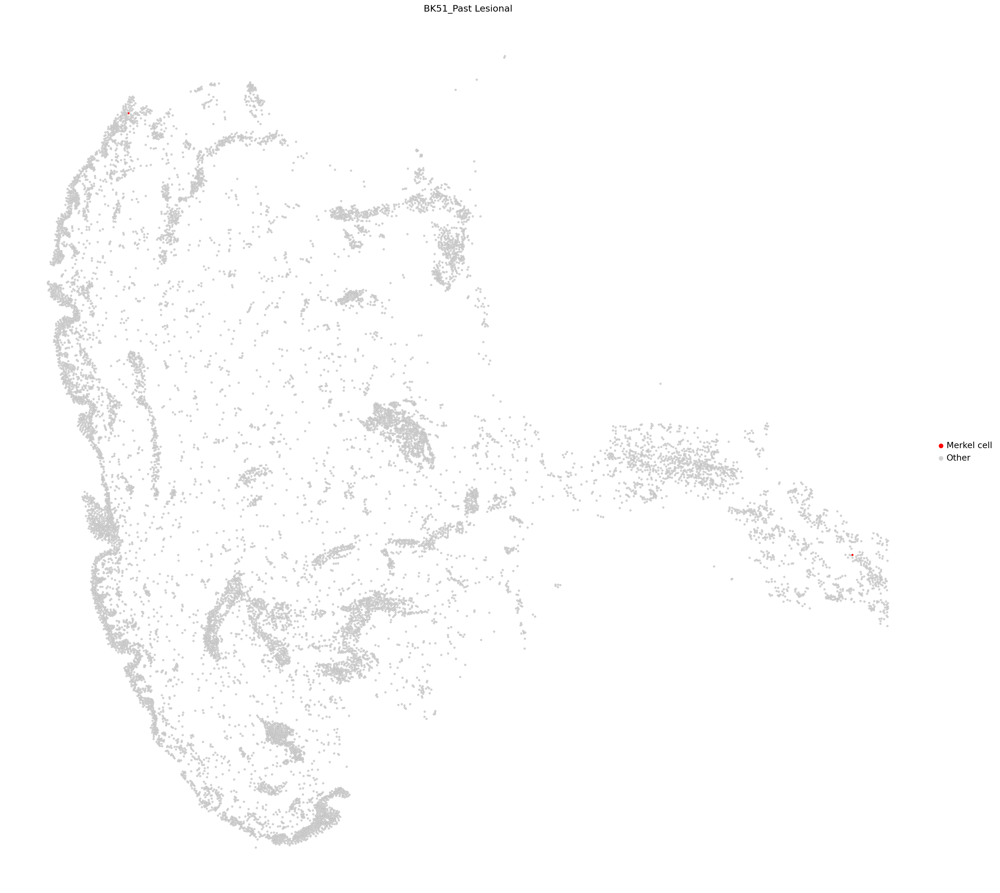

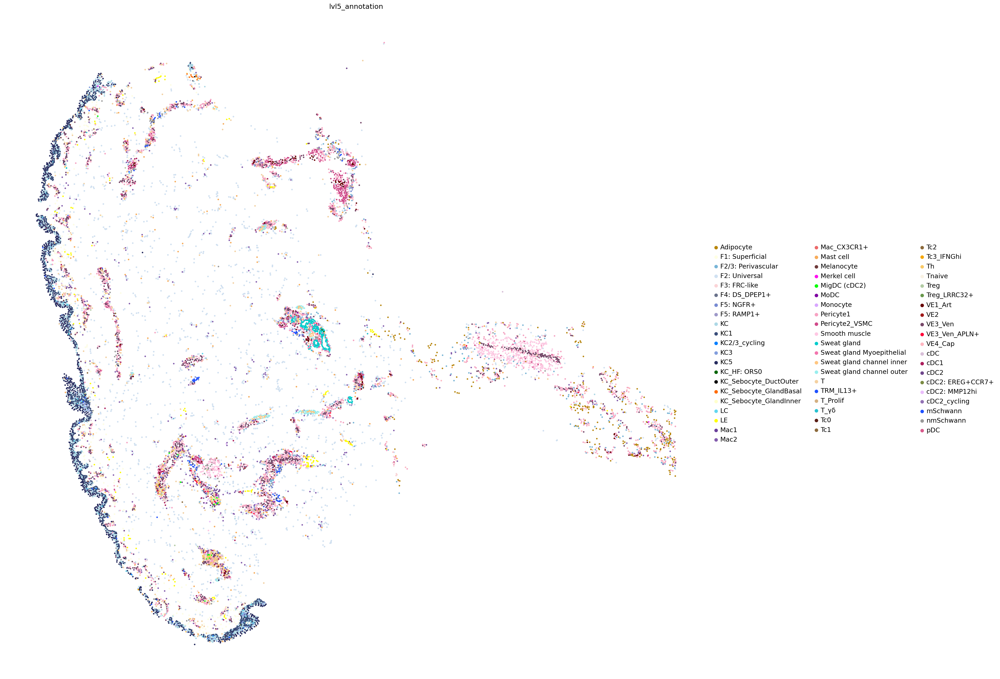

In [14]:

#['Mac', 'Mac_CCL14hi', 'Mac LPLhi', 'Mac_prolif/PreDC', 'Mac LPLhi (P2RY12-)']

CELL_TYPE = 'Merkel cell'
MIN_CELL_COUNT=1


i=0

for tissue_section_id in [ 'BK51_Past Lesional']  :
    adata_i =  adata_5k[adata_5k.obs["info_id6"]==tissue_section_id]
    adata_i.obs["test"] = [x if x == CELL_TYPE else "Other" for x in adata_i.obs["lvl5_annotation"]]
    NUM = ord(CELL_TYPE[0])
    if NUM <79:
        custom_palette =[  "red",  "lightgrey"]
    else:
        custom_palette = [  "lightgrey", "red"]
    sc.pl.spatial(
            adata_i,
           # library_id="spatial",
           # shape=None,
            color="test",
            spot_size=10,
            vmax=1,
            #title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
            palette=custom_palette,
            edgecolor='black',
            linewidth=0.05,
        title=tissue_section_id,
        save="supp1d_Merkel_cell.pdf"
            #ax=ax,
            #legend_loc="on data"  # Disable the legend for each subplot
        )
    sc.pl.spatial(
            adata_i,
            #library_id="spatial",
            #shape=None,
            color="lvl5_annotation",
            spot_size=10,
            vmax=1,
            #title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
          #  palette=custom_palette,
            edgecolor='black',
            linewidth=0.01,
            #ax=ax,
            #legend_loc="on data"  # Disable the legend for each subplot
        )
#             if i >5:
#                 print("6 samples found already ... Terminate")
#                 break


0 False
0 True
BK49_Past Lesional wk8 relaspe - Cell count:  1
Non-lesional  - does not contain  F4: DP_HHIP+ . Count is  1
0 True
BK46_Never Lesional - Cell count:  2
Non-lesional  - does not contain  F4: DP_HHIP+ . Count is  2
0 False
0 True
BK51_wk8 Relapse - Cell count:  2
Lesional  - does not contain  F4: DP_HHIP+ . Count is  2
0 True
BK46_Past Lesional - Cell count:  1
Non-lesional  - does not contain  F4: DP_HHIP+ . Count is  1
0 False
0 True
BK43_Never Lesional - Cell count:  4
Non-lesional  - does not contain  F4: DP_HHIP+ . Count is  4
0 False
0 True
BK49_Past Lesional - Cell count:  3
Non-lesional  - does not contain  F4: DP_HHIP+ . Count is  3
0 False
0 False
0 False
0 False
0 False
0 True
BK23_Week 12 - Cell count:  1
Week 12  - does not contain  F4: DP_HHIP+ . Count is  1
0 False
0 True
BK23_Lesional Baseline - Cell count:  2
Lesional  - does not contain  F4: DP_HHIP+ . Count is  2
0 False
0 True
BK27_Week 12 - Cell count:  5
Week 12  - does not contain  F4: DP_HHIP+ . Co

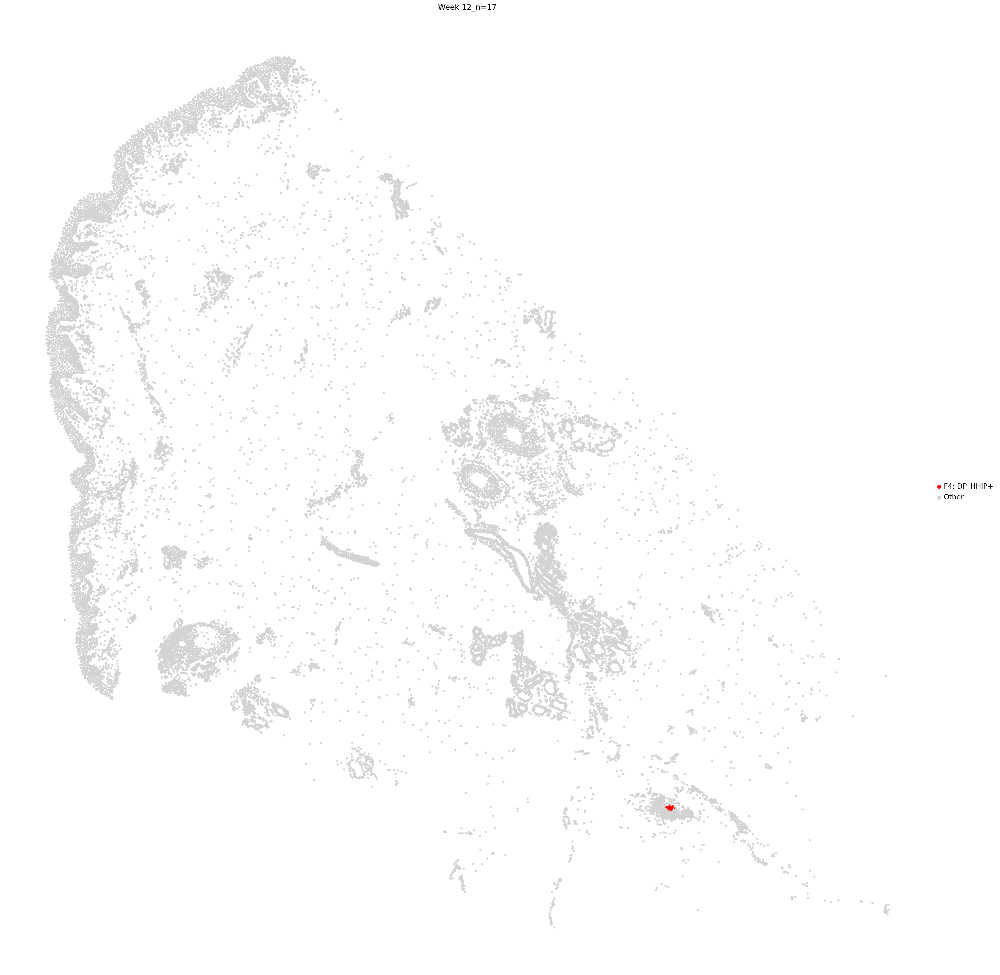

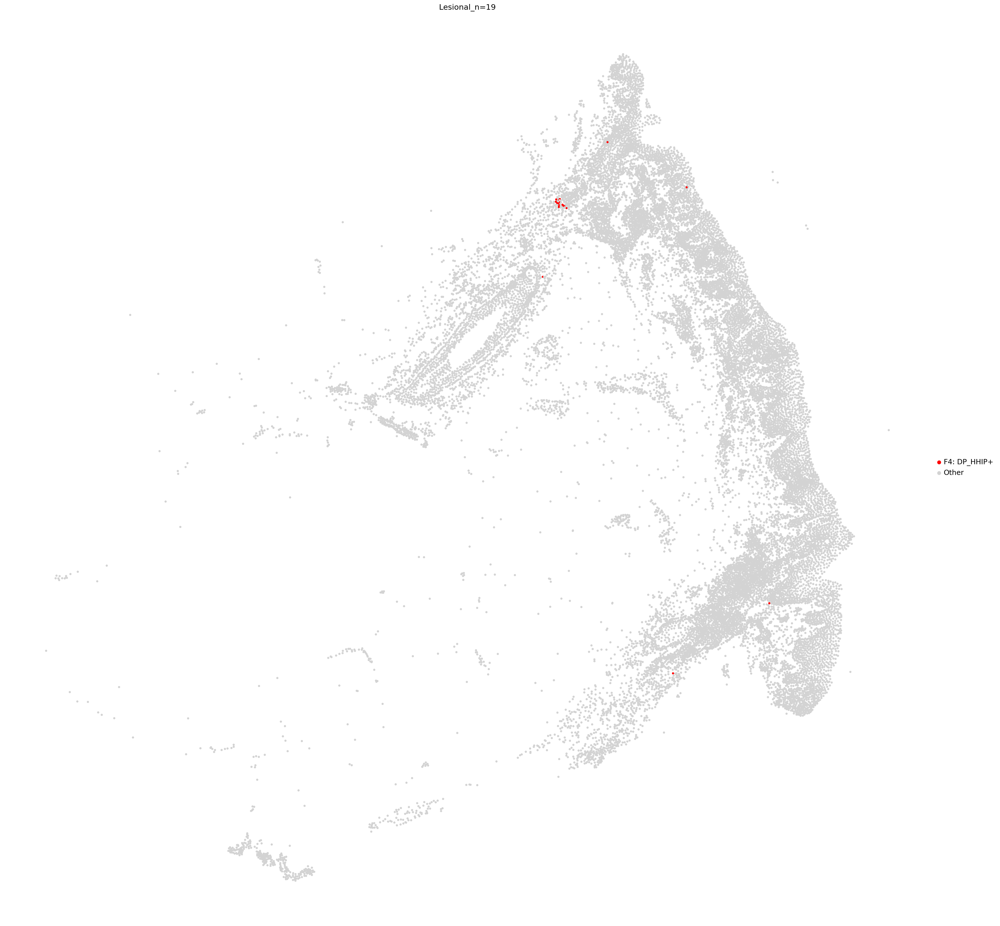

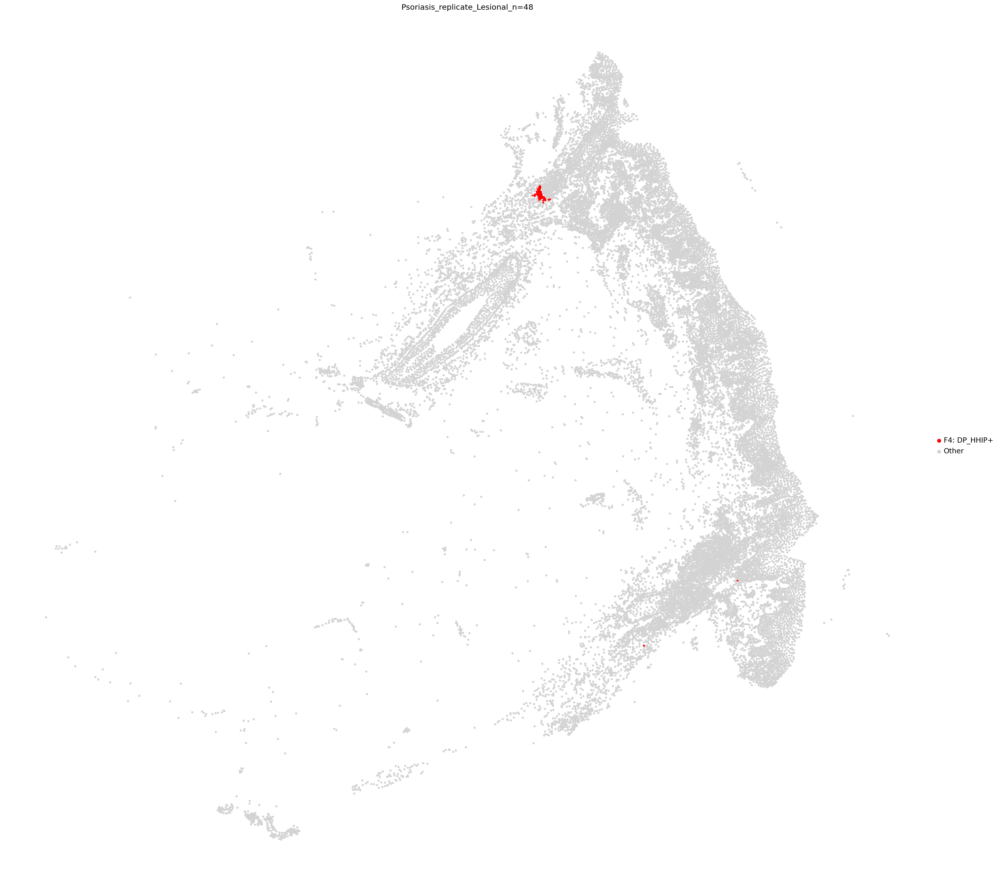

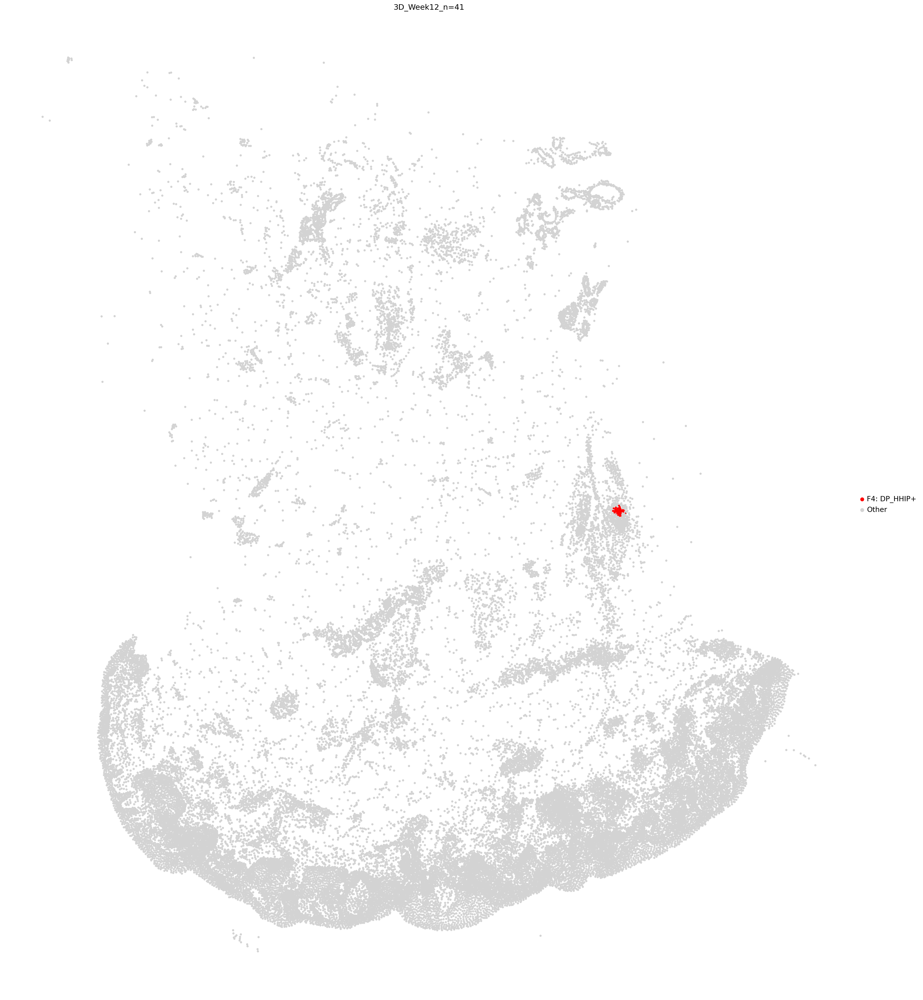

In [15]:

#['Mac', 'Mac_CCL14hi', 'Mac LPLhi', 'Mac_prolif/PreDC', 'Mac LPLhi (P2RY12-)']

CELL_TYPE = 'F4: DP_HHIP+'
MIN_CELL_COUNT=10


i=0
#adata_5k=adata_5k[adata_5k.obs["Site_status_binary"]=="Lesional"]
for tissue_section_id in adata_5k.obs["sample_id"].unique():
    adata_i =  adata_5k[adata_5k.obs["sample_id"]==tissue_section_id]
    niche_names_found = adata_i.obs["Annotation"].unique()
    STATUS =  adata_i.obs["Site_status"].unique()[0]
    print(i, CELL_TYPE in niche_names_found)
#     if tissue_section_id=="output-XETG00335__0044073__BK49-SKI-24-FO-1-s2_BK50-SKI-27-FO-1-s2__20250210__163417":
#         print(tissue_section_id)
#         display(adata_i.obs["Annotation"].value_counts())
    if CELL_TYPE in niche_names_found:
        CELL_COUNT_IN_SECTION=adata_i[adata_i.obs["Annotation"]==CELL_TYPE].shape[0]
        print(tissue_section_id, "- Cell count: ", CELL_COUNT_IN_SECTION)

        if CELL_COUNT_IN_SECTION > MIN_CELL_COUNT:
    #         if i ==0:

    #             sq.pl.spatial_scatter(
    #                 adata_i,
    #                 library_id="spatial",
    #                 shape=None,
    #                 color="Annotation",
    #                 size=1,
    #                 vmax=1,
    #                 title=tissue_section_id,
    #                 #ax=ax,
    #                 #legend_loc="on data"  # Disable the legend for each subplot
    #             )       
            i=i+1

            #print(tissue_section_id)
    #         sq.pl.spatial_scatter(
    #             adata_i,
    #             library_id="spatial",
    #             shape=None,
    #             color="Annotation",
    #             size=5,
    #             vmax=1,
    #             title=tissue_section_id,
    #             #ax=ax,
    #             legend_loc="on data"  # Disable the legend for each subplot
    #         )
            adata_i.obs["test"] = [x if x == CELL_TYPE else "Other" for x in adata_i.obs["Annotation"]]
            NUM = ord(CELL_TYPE[0])
            if NUM <79:
                custom_palette =ListedColormap([  "red",  "lightgrey"])
            else:
                custom_palette = ListedColormap([  "lightgrey", "red"])
            sq.pl.spatial_scatter(
                    adata_i,
                    library_id="spatial",
                    shape=None,
                    color="test",
                    size=30,
                    vmax=1,
                    title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
                    palette=custom_palette,

                    #ax=ax,
                    #legend_loc="on data"  # Disable the legend for each subplot
                )
#             if i >5:
#                 print("6 samples found already ... Terminate")
#                 break
        else:
             print(STATUS, " - does not contain ", CELL_TYPE, ". Count is " , CELL_COUNT_IN_SECTION,)# " - i=", i)

0 False
0 False
0 False
0 False
0 False
0 True
BK46_Past Lesional - Cell count:  1
1 False
1 False
1 False
1 False
1 False
1 False
1 True
BK50_Never Lesional - Cell count:  1
2 True
BK51_Past Lesional - Cell count:  1
3 False
3 False
3 False
3 False
3 False
3 False
3 False
3 False
3 False
3 False
3 False
3 False
3 False
3 False
3 False
3 False
3 False
3 False
3 True
BK39_Non-lesional Baseline - Cell count:  1
4 False
4 False
4 False
4 False
4 False
4 False
4 False
4 False
4 False
4 False
4 False
4 False
4 False
4 False
4 False
4 False
4 False
4 False
4 False
4 False
4 True
Week 8 (resolved)_CE3-SKI-28-FO-4-S22-E1_a - Cell count:  3
5 False
5 False
5 False
5 False
5 False
5 True
Baseline_never_CE3-SKI-28-FO-2-S22-C1 - Cell count:  1
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 False
6 

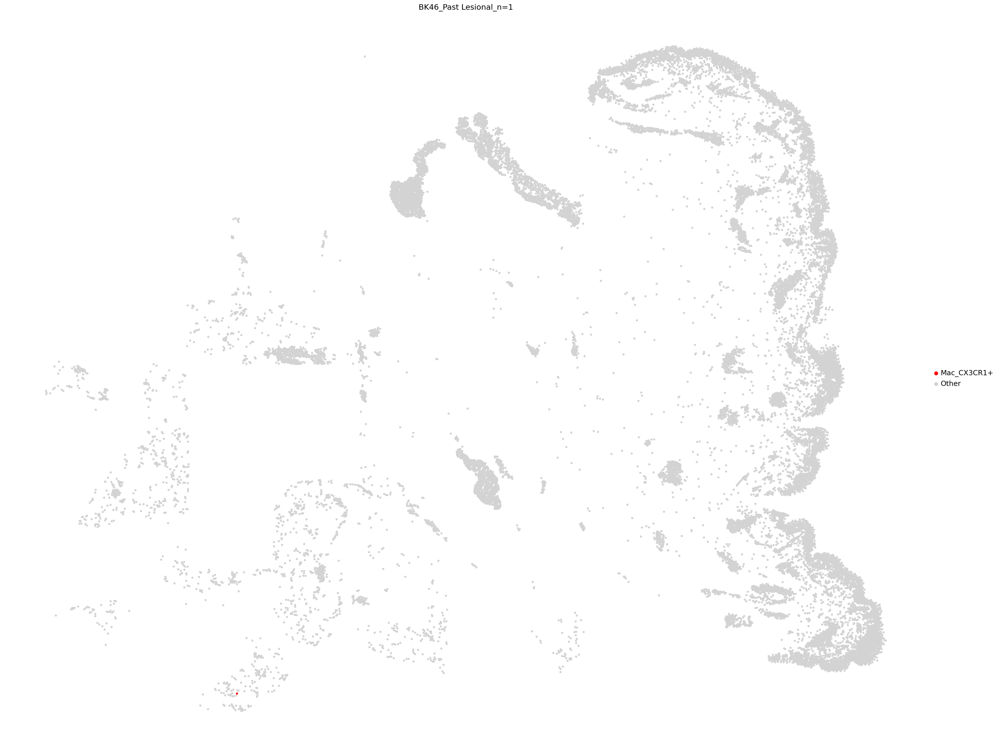

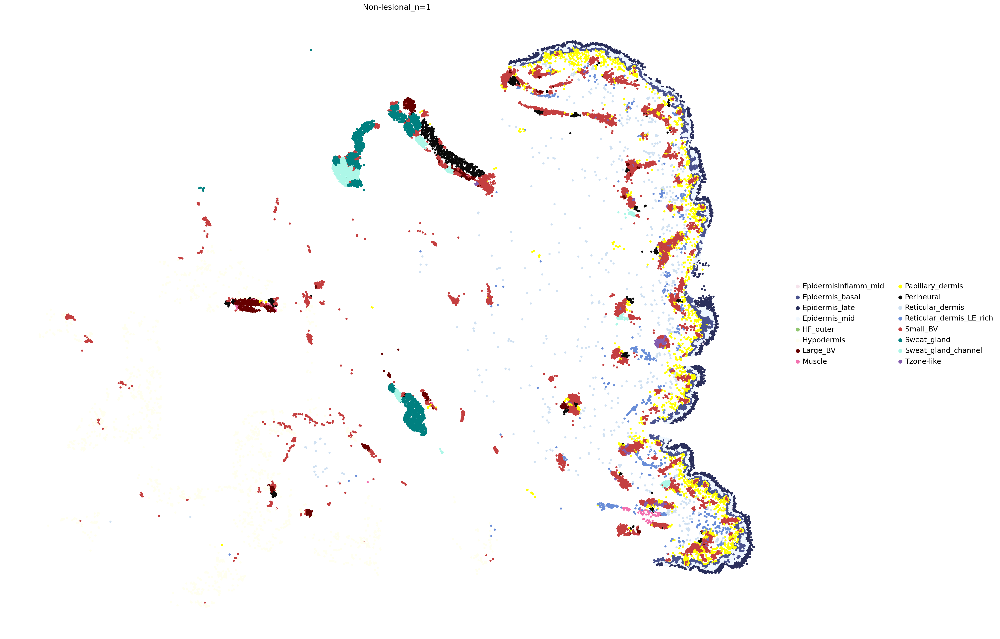

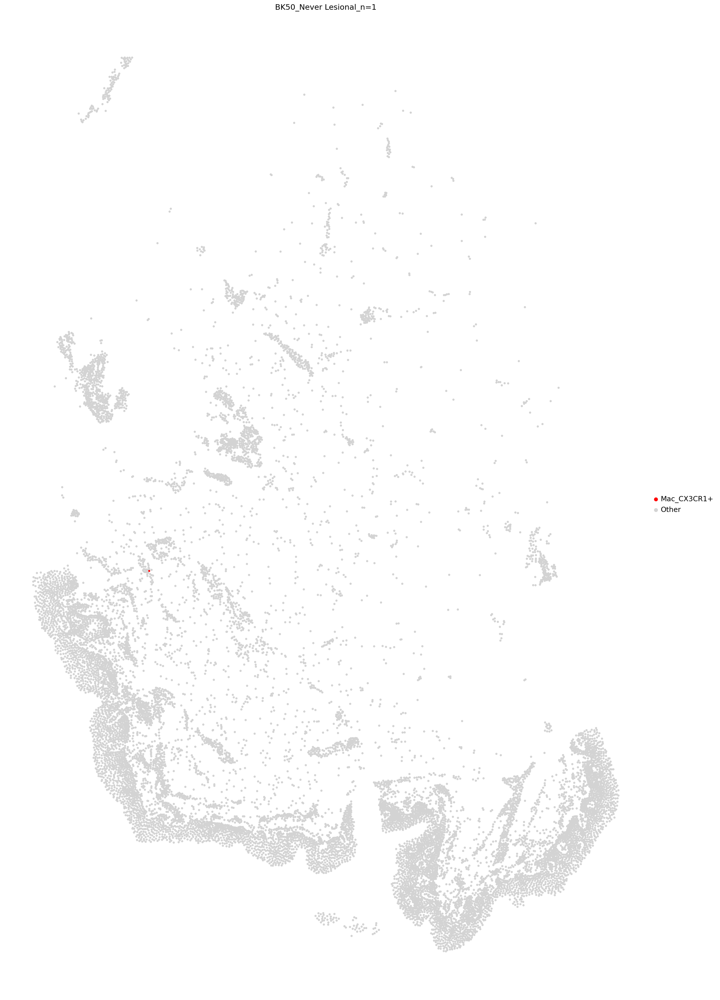

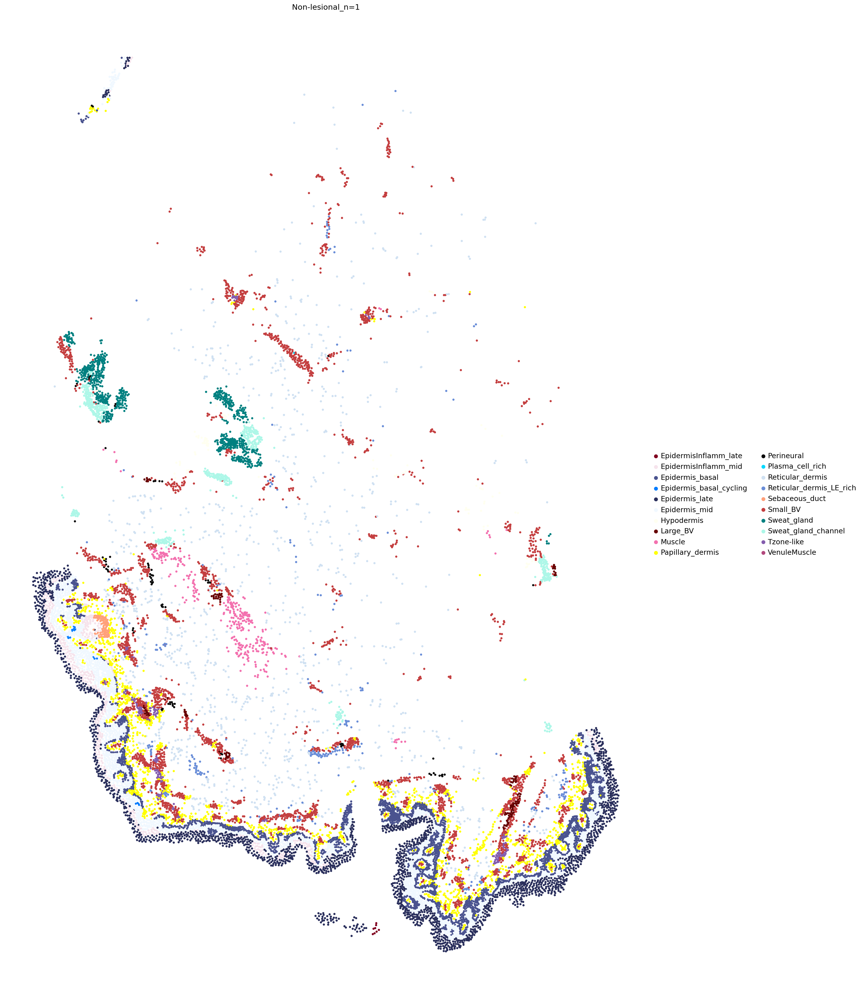

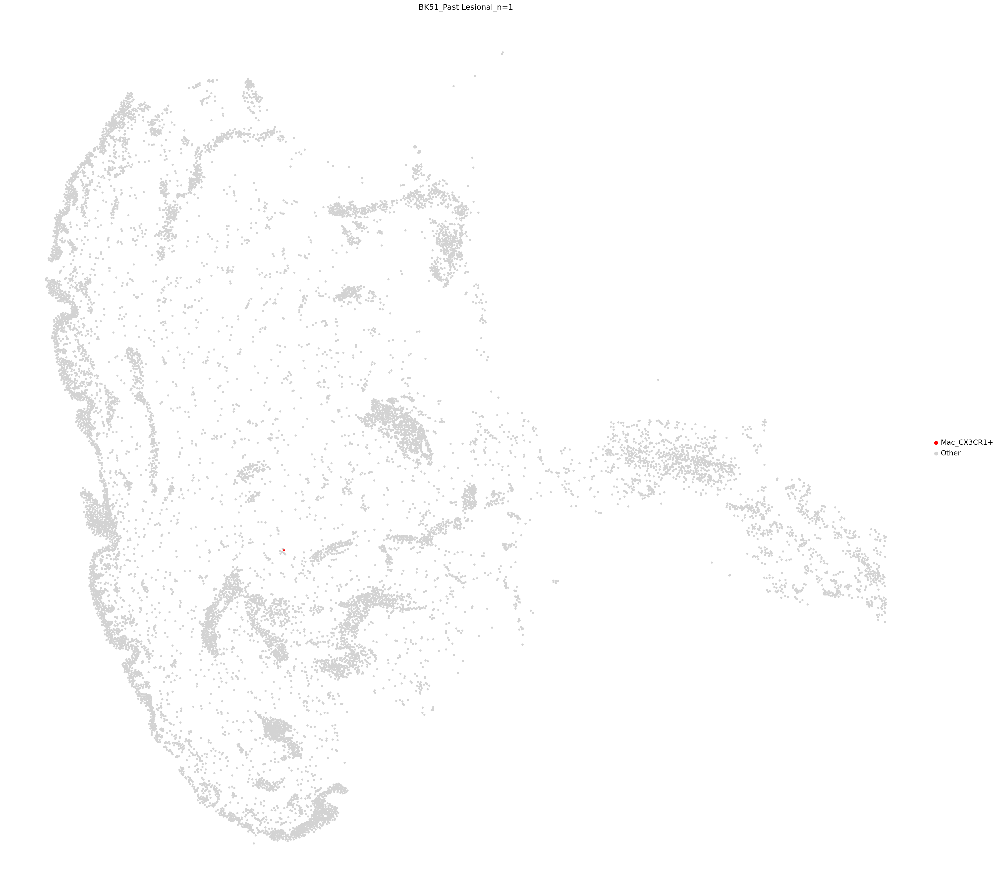

...

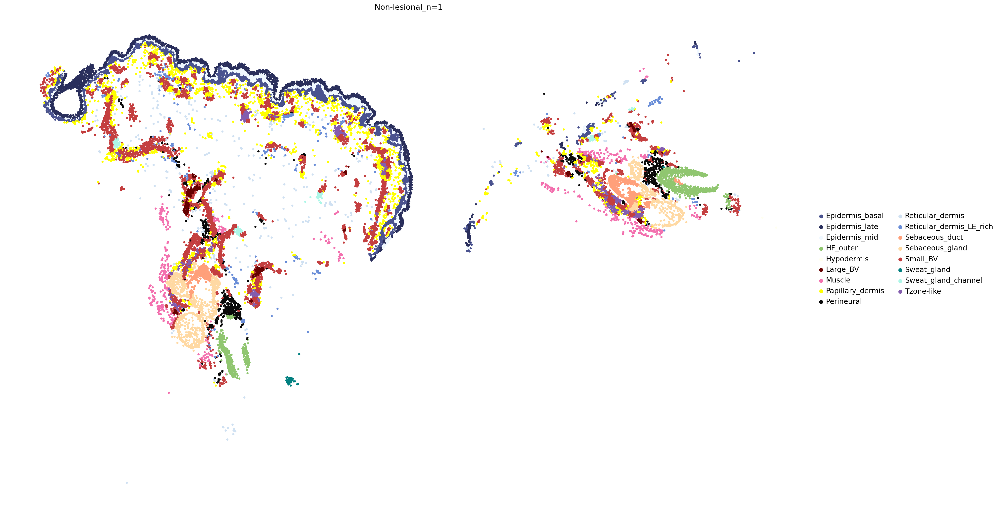

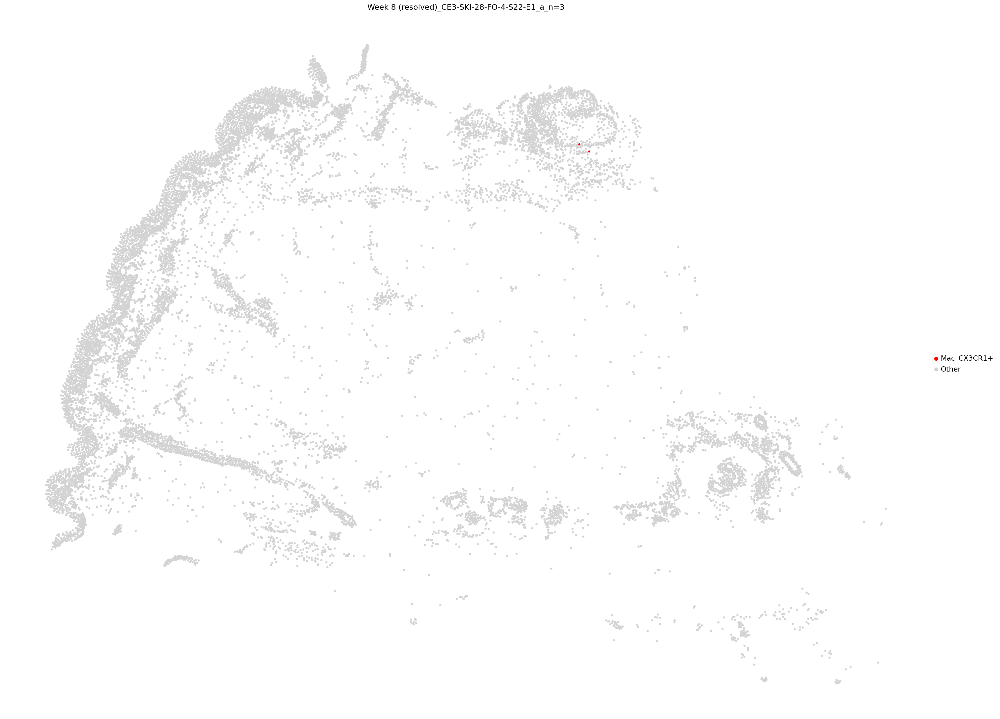

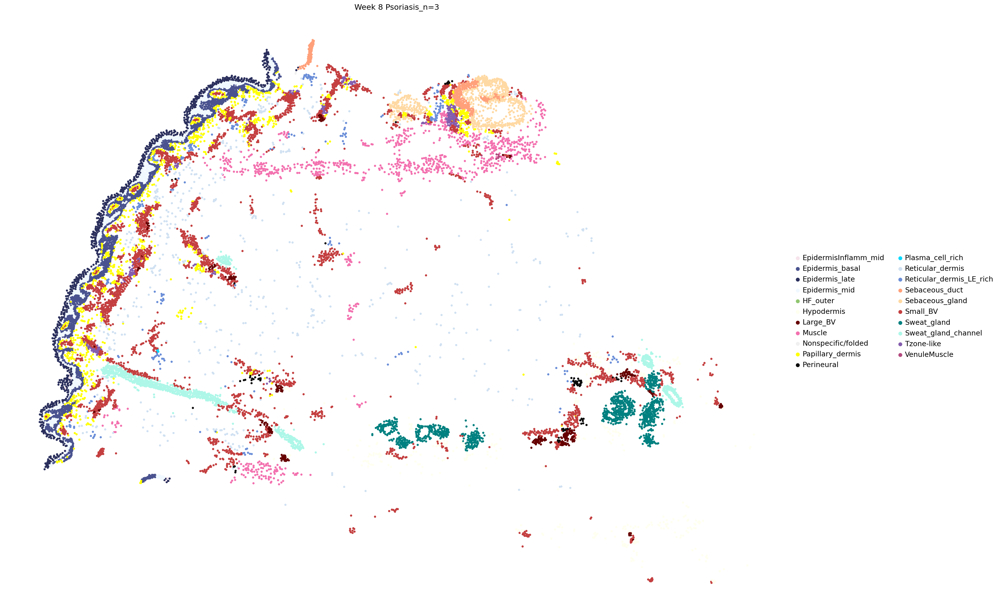

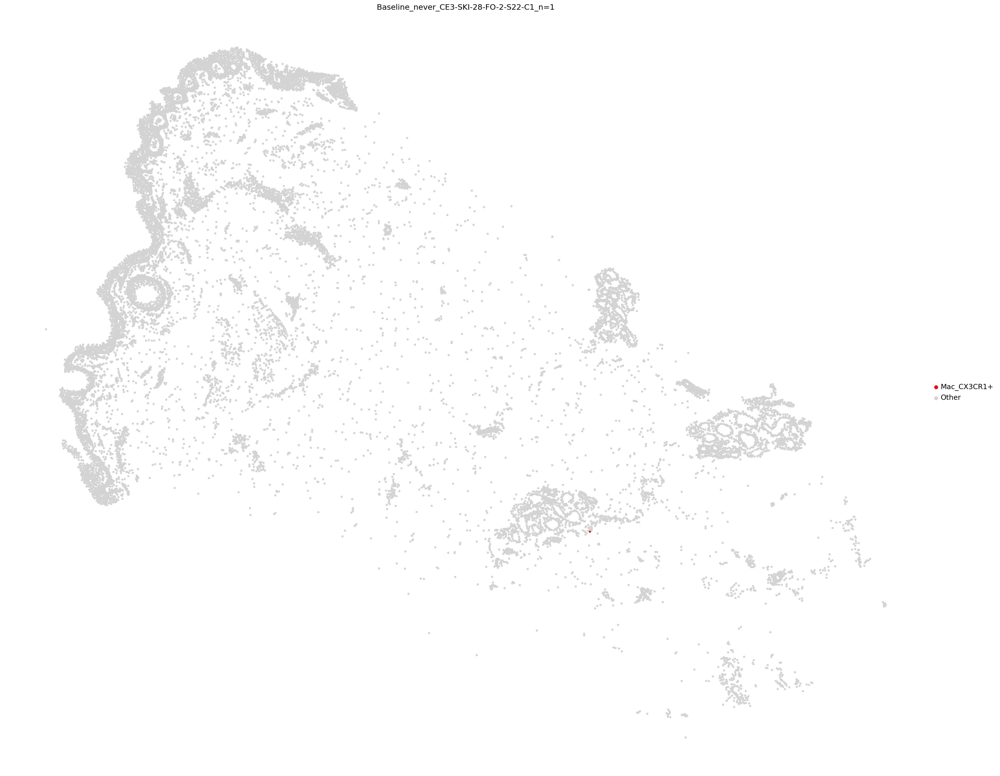

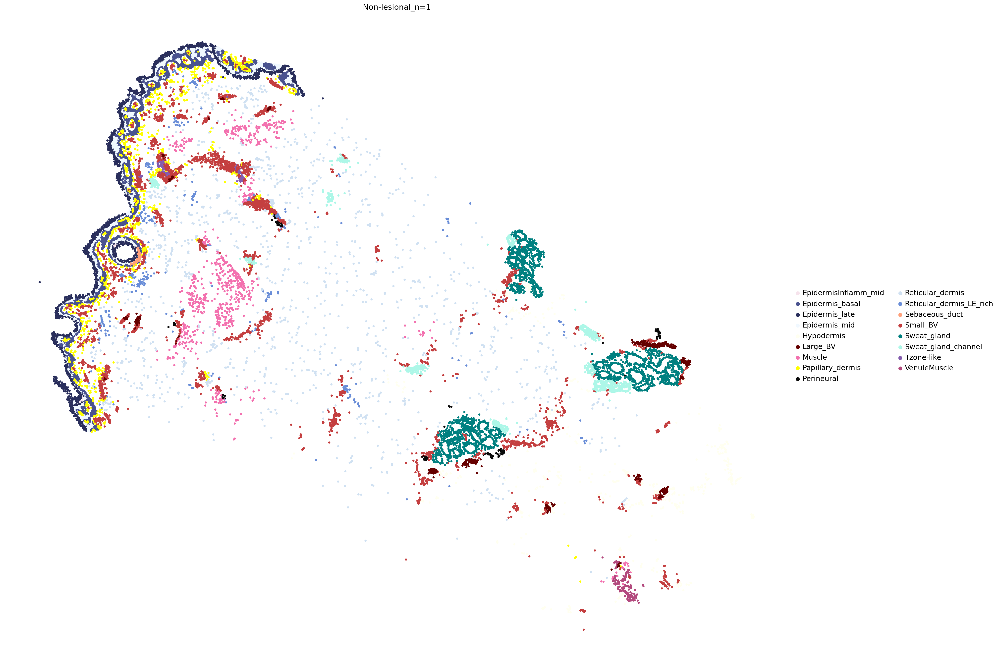

In [19]:

#['Mac', 'Mac_CCL14hi', 'Mac LPLhi', 'Mac_prolif/PreDC', 'Mac LPLhi (P2RY12-)']

CELL_TYPE = 'Mac_CX3CR1+'
MIN_CELL_COUNT=0


i=0
#adata_5k=adata_5k[adata_5k.obs["Site_status_binary"]=="Lesional"]
for tissue_section_id in adata_5k.obs["info_id6"].unique():
    adata_i =  adata_5k[adata_5k.obs["info_id6"]==tissue_section_id]
    niche_names_found = adata_i.obs["Annotation"].unique()
    STATUS =  adata_i.obs["Site_status"].unique()[0]
    print(i, CELL_TYPE in niche_names_found)
#     if tissue_section_id=="output-XETG00335__0044073__BK49-SKI-24-FO-1-s2_BK50-SKI-27-FO-1-s2__20250210__163417":
#         print(tissue_section_id)
#         display(adata_i.obs["Annotation"].value_counts())
    if CELL_TYPE in niche_names_found:
        CELL_COUNT_IN_SECTION=adata_i[adata_i.obs["Annotation"]==CELL_TYPE].shape[0]
        print(tissue_section_id, "- Cell count: ", CELL_COUNT_IN_SECTION)

        if CELL_COUNT_IN_SECTION > MIN_CELL_COUNT:
    #         if i ==0:

    #             sq.pl.spatial_scatter(
    #                 adata_i,
    #                 library_id="spatial",
    #                 shape=None,
    #                 color="Annotation",
    #                 size=1,
    #                 vmax=1,
    #                 title=tissue_section_id,
    #                 #ax=ax,
    #                 #legend_loc="on data"  # Disable the legend for each subplot
    #             )       
            i=i+1

            #print(tissue_section_id)
    #         sq.pl.spatial_scatter(
    #             adata_i,
    #             library_id="spatial",
    #             shape=None,
    #             color="Annotation",
    #             size=5,
    #             vmax=1,
    #             title=tissue_section_id,
    #             #ax=ax,
    #             legend_loc="on data"  # Disable the legend for each subplot
    #         )
            adata_i.obs["test"] = [x if x == CELL_TYPE else "Other" for x in adata_i.obs["Annotation"]]
            NUM = ord(CELL_TYPE[0])
            if NUM <79:
                custom_palette =ListedColormap([  "red",  "lightgrey"])
            else:
                custom_palette = ListedColormap([  "lightgrey", "red"])
            sq.pl.spatial_scatter(
                    adata_i,
                    library_id="spatial",
                    shape=None,
                    color="test",
                    size=30,
                    vmax=1,
                    title=tissue_section_id + "_n=" + str(CELL_COUNT_IN_SECTION),
                    palette=custom_palette,

                    #ax=ax,
                    #legend_loc="on data"  # Disable the legend for each subplot
                )
            
            sq.pl.spatial_scatter(
                    adata_i,
                    library_id="spatial",
                    shape=None,
                    color="niche19",
                    size=30,
                    vmax=1,
                    title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
                    #palette=custom_palette,

                    #ax=ax,
                    #legend_loc="on data"  # Disable the legend for each subplot
                )
#             if i >5:
#                 print("6 samples found already ... Terminate")
#                 break
        else:
             print(STATUS, " - does not contain ", CELL_TYPE, ". Count is " , CELL_COUNT_IN_SECTION,)# " - i=", i)

In [ ]:
do we have H+E for 